In [2]:
import numpy as np 
import gudhi
from sklearn import preprocessing
from sklearn.decomposition import PCA
from scipy.spatial.distance import cdist, pdist, squareform
from DensiTDA import landmarktools
from DensiTDA import alphatools 
from DensiTDA import graphtools 
from scipy.sparse.csgraph import minimum_spanning_tree
import numpy as np
from matplotlib import pylab as plt

def merge(list1, list2):

    merged_list = [(list1[i], list2[i]) for i in range(0, len(list1))]
    
    return merged_list

In [8]:
A = np.fromfile("datasets/natural_images/V1_18.bin", dtype='uint16', sep="")
Rows = 444 
Cols = 1440 

offset = 2
image_range = A[offset:offset + Rows * Cols].reshape([Cols, Rows]).T
offset += Rows * Cols 

intensity = A[offset:offset + Rows * Cols].reshape([Cols, Rows]).T
offset += Rows * Cols 

bearing = A[offset:offset + Rows * Cols].reshape([Cols, Rows]).T
offset += Rows * Cols 

inclination =  A[offset:offset + Rows * Cols].reshape([Cols, Rows]).T
#A = A.reshape([444, 1440])
#plt.imshow(A)

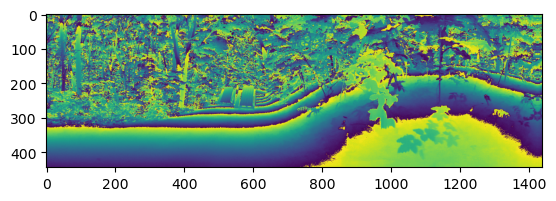

In [9]:
plt.imshow(image_range)

In [10]:
image_range

array([[    0, 33801, 35337, ..., 40195, 42755, 40963],
       [    0, 40969, 41993, ..., 46083, 46083, 48899],
       [    0, 40201, 48905, ..., 46083, 43779, 43779],
       ...,
       [ 5633,  4609,  4609, ..., 60928, 60672, 60416],
       [ 4609,  4609,  4609, ..., 59904, 59392, 59648],
       [ 4609,  4609,  3841, ..., 58880, 59392, 59648]], dtype=uint16)

# Extract Data

In [2]:
folder = 'Toroidal_topology_grid_cell_data//' # directory to data

In [3]:
## Iterates over the different datasets
for rat_name, mod_name, sess_name, day_name in [ ('R', '2', 'OF', 'day1') ]:
    
    if sess_name in ('OF', 'WW'):
        sspikes, xx, yy, aa, tt = get_spikes(rat_name, mod_name, day_name, sess_name, bType = 'pure',
                                         bSmooth = True, bSpeed = True, folder = folder )
    else:
        sspikes = get_spikes(rat_name, mod_name, day_name, sess_name, bType = 'pure', bSmooth = False, bSpeed = False, folder = folder)


In [4]:
sspikes.shape

(766731, 149)

# Extract Actively Moving Times

In [5]:
x_min = min(xx)
x_max = max(xx)

y_min = min(yy)
y_max = max(yy)

N_T, N_N = sspikes.shape

In [6]:
# generate D^k
D_k = []

for k in range(N_N):
    indices = sspikes[:,k] >= 0.99
    curr_D_k = merge(xx[indices], yy[indices])    
    D_k.append(curr_D_k)

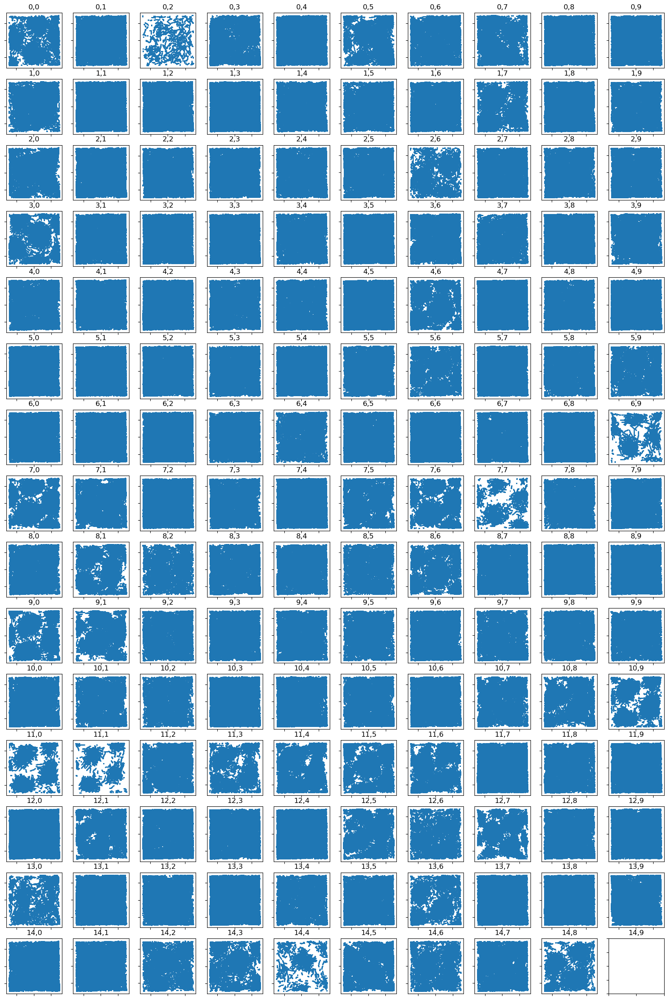

In [7]:
columns = 10
rows = 15
k = 0
fig, ax_array = plt.subplots(rows, columns, squeeze=False, figsize=(20,30))
for i,ax_row in enumerate(ax_array):
    for j,axes in enumerate(ax_row):
        axes.set_title('{},{}'.format(i,j))
        axes.set_yticklabels([])
        axes.set_xticklabels([])
        if k < N_N:
            plot_array = np.array(D_k[k])
            axes.scatter(plot_array[:,0], plot_array[:,1], s=1, alpha=1)
            k += 1
        else:
            break

plt.show()

In [8]:
delta_x = xx[1:] - xx[:-1]
delta_y = yy[1:] - yy[:-1]
delta_t = tt[1:] - tt[:-1]

In [9]:
speed = []

for del_x, del_y, del_t in zip(delta_x, delta_y, delta_t):
    speed.append(np.sqrt(del_x ** 2 + del_y ** 2) / del_t)

speed.append(0)

In [10]:
min_speed_consideration = np.mean(speed) + 3 * np.std(speed)


In [11]:
active_times = speed > min_speed_consideration

In [12]:
X = sspikes[active_times]

In [13]:
speedy_xx = xx[active_times]

In [14]:
speedy_yy = yy[active_times]

In [15]:
N_T, N_N = X.shape

In [16]:
# generate D^k
D_k = []

for k in range(N_N):
    indices = X[:,k] >= 0.99
    curr_D_k = merge(speedy_xx[indices], speedy_yy[indices])    
    D_k.append(curr_D_k)

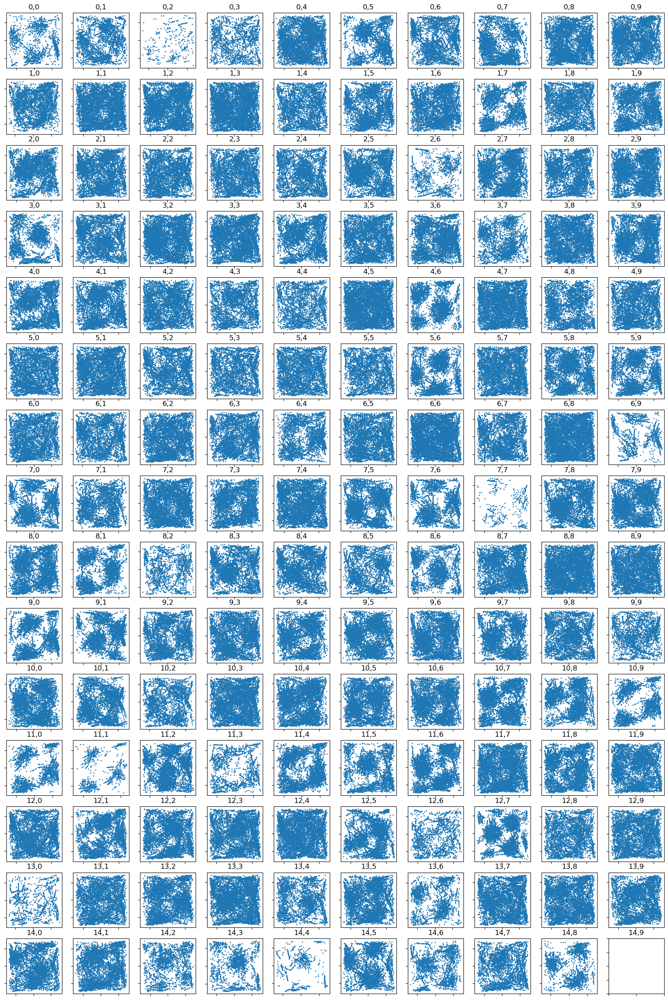

In [17]:
columns = 10
rows = 15
k = 0
fig, ax_array = plt.subplots(rows, columns, squeeze=False, figsize=(20,30))
for i,ax_row in enumerate(ax_array):
    for j,axes in enumerate(ax_row):
        axes.set_title('{},{}'.format(i,j))
        axes.set_yticklabels([])
        axes.set_xticklabels([])
        if k < N_N:
            plot_array = np.array(D_k[k])
            axes.scatter(plot_array[:,0], plot_array[:,1], s=1, alpha=1)
            k += 1
        else:
            break

plt.show()

# Project Down into $\mathbb R^6$

In [18]:
pca = PCA(n_components=6, svd_solver='full')
Y = pca.fit_transform(preprocessing.scale(X))

In [19]:
Y.shape

(10852, 6)

In [20]:
Y = np.divide(Y.T, np.linalg.norm(Y, axis=1)).T

# Landmark on $\mathbb S^5$

In [21]:
# hyperparameters
d = Y.shape[1]
h = np.std(Y) * (len(Y)) ** (-1 / (d + 4))
t = 1 / h ** 2
A = np.ones(len(Y)) / (h * len(Y))
s = 0.6

In [22]:
chosen_landmarks, chosen_powers = landmarktools.optimal_spherical_landmarking(Y, A, t, s, np.log(s))

Calculating Projections p(x)


100%|█████████████████████████████████████████| 11/11 [00:00<00:00, 2006.49it/s]

Calculating tilde f(y)



100%|████████████████████████████████████████| 11/11 [00:00<00:00, 13412.02it/s]


5.302145665119651
Greedy algorithm


100%|███████████████████████████████████| 10852/10852 [00:03<00:00, 2964.83it/s]


In [23]:
print("Precentage of points selected: ", 100 * len(chosen_landmarks) / len(X))

Precentage of points selected:  16.844821231109474


# Identify Average Distance

In [24]:
distance_distribution = squareform(pdist(chosen_landmarks))

In [25]:
distances = minimum_spanning_tree(distance_distribution)

In [26]:
alpha = np.max(np.max(distances, axis=1))

In [27]:
alpha

0.2737170915995919

In [28]:
alpha = 0.15

# Construct Alpha Complex on Landmarked Points

In [29]:
S = np.array(chosen_landmarks)

In [30]:
P = np.zeros(len(chosen_landmarks))
D = 3

In [31]:
my_alpha_complex = alphatools.compute_alpha_complex(S, P, alpha, D)

Generating 1-Dimensional Weighted Cech Complex


100%|█████████████████████████████████████████████| 2/2 [00:03<00:00,  1.81s/it]

	Total Edges of Cech Graph:  141389
	Highest Degree of Cech Graph:  215
	Average Degree of Cech Graph:  154.6925601750547
	Number of Connected Components:  1
Begin Computing Alpha Complex
Preprocessing Dual Matrices:  1828



100%|█████████████████████████████████████████████| 2/2 [00:01<00:00,  1.33it/s]


*********** BEGIN DIMENSION 0 ***********
	Possible Facets:  1828


100%|████████████████████████████████████| 1828/1828 [00:00<00:00, 20448.12it/s]

	Final Number of Facets:  1828
*********** BEGIN DIMENSION 1 ***********
	Possible Facets:  141389



100%|█████████████████████████████████████████████| 2/2 [00:07<00:00,  3.60s/it]


	Final Number of Facets:  29443
*********** BEGIN DIMENSION 2 ***********
Estimating Number of Facets for dimension  2
	Possible Facets:  144117


100%|█████████████████████████████████████████████| 2/2 [00:07<00:00,  3.68s/it]


	Final Number of Facets:  114972
*********** BEGIN DIMENSION 3 ***********
Estimating Number of Facets for dimension  3
	Possible Facets:  1763872


100%|███████████████████████████████████████████| 18/18 [00:24<00:00,  1.36s/it]


	Final Number of Facets:  184436


In [32]:
filtration = []
for d in range(D + 1):
    filtration += my_alpha_complex[d]

In [33]:
example2 = gudhi.SimplexTree()
for d in range(D + 1):
    for facet, val in my_alpha_complex[d]:
        example2.insert(facet, filtration=val)
        
my_persistence = example2.persistence(homology_coeff_field = 2)

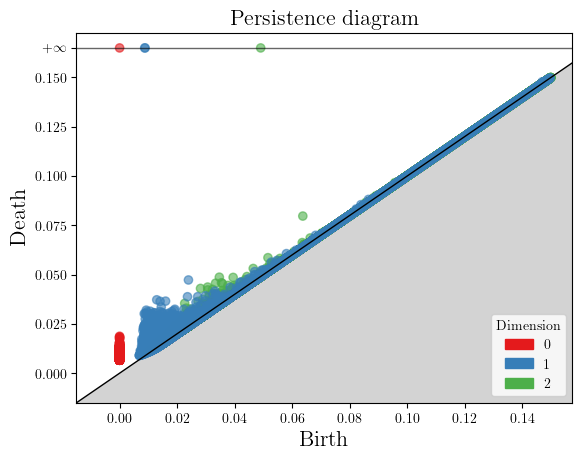

In [34]:
gudhi.plot_persistence_diagram(my_persistence, legend=True)
plt.show()

In [35]:
betti_numbers = {}
for i in range(D):
    betti_numbers[i] = 0
for bar, bd in my_persistence:
    if bd[1] > 10000: 
        betti_numbers[bar] += 1

print("Betti Numbers up to Dimension 3 over the field F_2")
betti_numbers

Betti Numbers up to Dimension 3 over the field F_2


{0: 1, 1: 2, 2: 1}

In [36]:
graphtools.draw_abstract_simplcial_complex(my_alpha_complex)

In [37]:
my_persistence = example2.persistence(homology_coeff_field = 3)

In [38]:
betti_numbers = {}
for i in range(D):
    betti_numbers[i] = 0
for bar, bd in my_persistence:
    if bd[1] > 10000: 
        betti_numbers[bar] += 1

print("Betti Numbers up to Dimension 3 over the field F_3")
betti_numbers

Betti Numbers up to Dimension 3 over the field F_3


{0: 1, 1: 2, 2: 1}